# **Forecasting energy consumption in the UK on a monthly basis using time series analysis** 

**Data Science Bootcamp Capston Project** - Simón Román O. [BrainStation, London, June 2023]

## **Table of contents**

1. Introduction
2. Imports
3. Data Load
4. Data Preview
5. Data Saving

### **1. Introduction** 

The objective of this project is to forecast UK energy monthly consumption. We recognize that an accurate forecasting model can be highly beneficial for various stakeholders in the energy production and distribution industry and everyday and commercial consumers.

The data used in this project was sourced from the National Grid ESO. It includes measurements recorded every 30 minutes from January 1, 2009, to March 12, 2023. The original data was resampled into daily and monthly periods to facilitate the analysis. The dataset comprises energy consumption (demand), solar and wind data, as well as import and export in various columns.

Accurate forecasting of energy consumption is crucial for effective resource planning, energy management, and policy-making. Time series models offer valuable tools for understanding the underlying dynamics and capturing the temporal dependencies present in the data.

#### **What is time series analysis?**
In broad terms, time series analysis involves the use of statistical tools to forecast or predict the future with the highest possible accuracy. This project's main objective is to utilize time series analysis and past numerical data (including exogenous data) to extract relevant information, such as underlying patterns, trends, and seasonality, to feed a forecasting model.


 ### **2. Imports** 

In [72]:
#Import all relevant libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.subplots import make_subplots

import importlib
import plotly.graph_objs as go
#from datetime import datetime, timedelta

In [35]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

 ### **3. Data load** 

In [36]:
#read csv and make firts column the index 
df = pd.read_csv('../data/historic_demand_2009_2023_noNaN.csv', index_col=0)

In [37]:
#Check the read was ok
df.head(5).T

settlement_date,2009-01-01 00:00:00,2009-01-01 00:30:00,2009-01-01 01:00:00,2009-01-01 01:30:00,2009-01-01 02:00:00
settlement_period,1,2,3,4,5
period_hour,0:00:00,0:30:00,1:00:00,1:30:00,2:00:00
nd,37910,38047,37380,36426,35687
tsd,38704,38964,38651,37775,37298
england_wales_demand,33939,34072,33615,32526,31877
embedded_wind_generation,54,53,53,50,50
embedded_wind_capacity,1403,1403,1403,1403,1403
embedded_solar_generation,0,0,0,0,0
embedded_solar_capacity,0,0,0,0,0
non_bm_stor,0,0,0,0,0


In [38]:
#Basic EDA function 
def basic_eda(df):

    print(f"Shape of the df: {df.shape}")
    print("**************************************************")    

    print(f"The datatype of the index is {type(df.index)}")
    print("**************************************************")

    print(f"Number of null values: {df.isna().sum().sum()}")
    print("**************************************************")      

    print(f"Number of duplicates: {df.duplicated().sum().sum()}")
    print("**************************************************")  

    print(f"Info of the df: {df.info()}")
    print("**************************************************")

basic_eda(df)

Shape of the df: (248084, 18)
**************************************************
The datatype of the index is <class 'pandas.core.indexes.base.Index'>
**************************************************
Number of null values: 0
**************************************************
Number of duplicates: 0
**************************************************
<class 'pandas.core.frame.DataFrame'>
Index: 248084 entries, 2009-01-01 00:00:00 to 2023-03-12 23:30:00
Data columns (total 18 columns):
 #   Column                     Non-Null Count   Dtype 
---  ------                     --------------   ----- 
 0   settlement_period          248084 non-null  int64 
 1   period_hour                248084 non-null  object
 2   nd                         248084 non-null  int64 
 3   tsd                        248084 non-null  int64 
 4   england_wales_demand       248084 non-null  int64 
 5   embedded_wind_generation   248084 non-null  int64 
 6   embedded_wind_capacity     248084 non-null  int64 
 7   e

Insights from the initial view of the DataFrame:

- The index is not set to the datetime data type.
- The period_hour column appears to be redundant since the index already includes hours and minutes.
- There are no null values or duplicates in the DataFrame.
- All columns have an equal number of values.
- All columns, except for period_hour, contain numeric data. However, the information provided by the period_hour column is already captured in the datetime index

In [46]:
#Make the index datetime 
df = df.set_index(pd.to_datetime(df.index))

#Check that everything is ok with the index
print(f"Index data type: {type(df.index)}")
print(f"Index in increasing order: {df.index.is_monotonic_increasing}")
print(f"Index with unique values: {df.index.is_unique}")

Index data type: <class 'pandas.core.indexes.datetimes.DatetimeIndex'>
Index in increasing order: True
Index with unique values: True


To perform time series analysis, it is crucial for the index to be in datetime format. This is because many operations and calculations rely on datetime features and characteristics. Additionally, it is important for the index to be in chronological order, ensuring that the data is arranged in increasing order of time, as verified in the code block above.

In [47]:
#Because or index is datetype we can drop the 'period_hours' column
df.drop('period_hour', axis=1, inplace=True)

In [48]:
#Determine time range for the series
f"The dataframe begins in {df.index.min()} and ends in {df.index.max()}"

'The dataframe begins in 2009-01-01 00:00:00 and ends in 2023-03-12 23:30:00'

In [49]:
#Check that te index is complete 
full_range = pd.date_range(start=df.index.min(), end=df.index.max(), freq="30T")

print(f"The index has {len(full_range.difference(df.index))} missing dates")

missing_dates = full_range.difference(df.index)
print(f"Missing dates:{missing_dates}") 
#These values were dropped in the EDA of the original dataset because they contained NaN values. 

The index has 748 missing dates
Missing dates:DatetimeIndex(['2009-03-29 23:00:00', '2009-03-29 23:30:00',
               '2009-08-29 00:00:00', '2009-08-29 00:30:00',
               '2009-08-29 01:00:00', '2009-08-29 01:30:00',
               '2009-08-29 02:00:00', '2009-08-29 02:30:00',
               '2009-08-29 03:00:00', '2009-08-29 03:30:00',
               ...
               '2018-03-25 23:00:00', '2018-03-25 23:30:00',
               '2019-03-31 23:00:00', '2019-03-31 23:30:00',
               '2020-03-29 23:00:00', '2020-03-29 23:30:00',
               '2021-03-28 23:00:00', '2021-03-28 23:30:00',
               '2022-03-27 23:00:00', '2022-03-27 23:30:00'],
              dtype='datetime64[ns]', length=748, freq=None)


In [50]:
#Numeric summary of the distribution of the data 
df.describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
settlement_period,248084.0,24.50,13.85,1.0,12.00,24.0,36.0,48.0
nd,248084.0,31876.76,7777.72,13367.0,25665.00,31323.0,37599.0,59095.0
tsd,248084.0,33327.49,7573.76,16629.0,27315.75,32543.0,38761.0,60147.0
england_wales_demand,248084.0,28997.29,7051.50,0.0,23339.00,28470.5,34228.0,53325.0
embedded_wind_generation,248084.0,1208.87,924.07,0.0,519.00,968.0,1643.0,5354.0
embedded_wind_capacity,248084.0,4196.61,1920.41,1403.0,2085.00,4136.0,6192.0,6574.0
embedded_solar_generation,248084.0,791.36,1588.09,0.0,0.00,0.0,723.0,9680.0
embedded_solar_capacity,248084.0,7730.00,5481.59,0.0,1817.00,9300.0,13080.0,13861.0
non_bm_stor,248084.0,7.49,41.46,-24.0,0.00,0.0,0.0,893.0
pump_storage_pumping,248084.0,321.42,545.04,0.0,8.00,12.0,473.0,2019.0


It does not seem normal that some columns have zero as minimun values. The energy grid is always working and reads should rarely be zero. Something to check for columns `england_wales_demand`, `embbeded_wind_generation`, `embedded_solar_generation`, `embedded_solar_capacity` and `pump_storage_pumping`. National demand basic statistics do not seem to have any unexpected values. 

In [51]:
#Resample the data set to monthy and daily dfs to visualize data in different intervals and fit models
df_monthly = df.resample("MS").sum()
df_daily = df.resample("D").sum()

In [52]:
#Check indexes
print(f"df_daily index data type: {type(df_daily.index)}")
print(f"df_monthy index data type: {type(df_monthly.index)}")

df_daily index data type: <class 'pandas.core.indexes.datetimes.DatetimeIndex'>
df_monthy index data type: <class 'pandas.core.indexes.datetimes.DatetimeIndex'>


In [53]:
#Check shapes
print(df.shape)
print(df_daily.shape)
print(df_monthly.shape)

(248084, 17)
(5184, 17)
(171, 17)


In [54]:
#Check changes in statistics after the resapling
df_monthly.describe().T

,count,mean,std,min,25%,50%,75%,max
settlement_period,171.0,3.554043e+04,2.013681e+03,14112.0,35280.0,36361.0,36456.0,36456.0
nd,171.0,4.624628e+07,7.305057e+06,18055775.0,40931297.5,46331575.0,50982974.0,65015253.0
tsd,171.0,4.835098e+07,7.381901e+06,19307129.0,42427875.0,48212329.0,52744942.0,67786726.0
england_wales_demand,171.0,4.206880e+07,6.545628e+06,16432905.0,37328490.0,42139038.0,46246545.5,58457975.0
embedded_wind_generation,171.0,1.753809e+06,8.730739e+05,442415.0,1029876.0,1645346.0,2401362.5,4798065.0
embedded_wind_capacity,171.0,6.088375e+06,2.823909e+06,1888320.0,3064656.0,6097601.0,8871913.5,9738960.0
embedded_solar_generation,171.0,1.148093e+06,1.107230e+06,0.0,156084.0,774066.0,2050561.0,3944149.0
embedded_solar_capacity,171.0,1.121456e+07,8.028327e+06,0.0,2689464.0,13485744.0,18835200.0,20625168.0
non_bm_stor,171.0,1.086102e+04,1.280900e+04,0.0,110.0,6137.0,17992.5,55822.0
pump_storage_pumping,171.0,4.663170e+05,1.237680e+05,122417.0,380984.0,512205.0,555412.0,661261.0


The min values turned to zero after resampling for `nd`, `tsd`, `embedded_wind_capacity`

In [55]:
#From the last_day variable we can see March 2023 might be an incomplete month
df_daily[df_daily.index > '2023-02-28']

,settlement_period,nd,tsd,england_wales_demand,embedded_wind_generation,embedded_wind_capacity,embedded_solar_generation,embedded_solar_capacity,non_bm_stor,pump_storage_pumping,ifa_flow,ifa2_flow,britned_flow,moyle_flow,east_west_flow,nemo_flow,is_holiday
settlement_date,,,,,,,,,,,,,,,,,
2023-03-01,1176,1534444,1692897,1402185,78241,314160,32113,627840,0,9614,-30658,-23308,42608,-20517,-19461,20962,0
2023-03-02,1176,1526780,1683497,1388341,42134,314160,67032,627840,0,7759,-34797,-13164,45170,-19121,-19491,26676,0
2023-03-03,1176,1562749,1696707,1433784,34843,314160,25247,627840,0,10242,6241,2449,48269,-20821,-22272,29351,0
2023-03-04,1176,1425857,1549372,1296513,25843,314160,22822,627840,0,9792,5343,1329,47786,-20743,-14038,34062,0
2023-03-05,1176,1412928,1492156,1282034,23220,314160,23642,627840,0,9471,32073,17879,48989,-18243,-11081,33674,0
2023-03-06,1176,1545240,1720577,1401367,85910,314160,32858,627840,0,8401,-58467,-24535,39496,-14458,-4072,22739,0
2023-03-07,1176,1560280,1695786,1415100,42968,314160,59134,627840,0,8251,-21024,-8401,48129,-17041,-11297,32328,0
2023-03-08,1176,1654428,1702331,1506114,64307,314160,23428,627840,0,8209,43632,24309,44908,-1074,1029,33411,0
2023-03-09,1176,1632729,1678704,1482863,89363,314160,15611,627840,0,7412,50619,22342,45830,13824,6277,36144,0


In [56]:
#Drop Ferbruary and March for monthly_df
df_monthly.drop(df_monthly[df_monthly.index >= '2023-02'].index, inplace=True)

The data for March 2023 was excluded from the monthly DataFrame because it contained only 12 days of data. Including such a short period would have distorted the representation of monthly intervals. Additionally, we decided to remove the data for February in order to have a larger number of data points available for comparison in a subsequent notebook for constructing a validation set.

### **3. Data Preview**

In [57]:
#Create list to visualize the three datasets in the same plot
df_list = ['df', 'df_daily', 'df_monthly']

#Set default figsize, increase width size
plt.rcParams['figure.figsize'] = (10, 5)

#### National Demand

In [58]:
#Plot National Demand
fig = make_subplots(rows=3, cols=1, subplot_titles=df_list)

for i, df_name in enumerate(df_list):
    fig.add_trace(go.Scatter(x=eval(df_name).index, y=eval(df_name)['nd'], mode='lines'), row=i+1, col=1)
    fig.update_yaxes(title_text='MW', row=i+1, col=1)

fig.update_layout(title='National Demand',  height=800, width=1050, xaxis_title='Date', showlegend=False)

fig.show()

The daily df has some issues product of the resampling, this values correspond to the missing dates in the index. We are going to impute the data. 

In [59]:
#Impute missing values
df_daily['nd'].replace(0, np.nan, inplace=True)
df_daily['nd'].fillna(method='ffill', inplace=True)

In [78]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_monthly.index, y=df_monthly['nd'], mode='lines'))

# Adding axis labels
fig.update_layout(
    yaxis_title='MW'
)

fig.update_layout(title="<b>UK's National Energy Demand</b>",  height=800, width=1050, xaxis_title='Date', showlegend=False)
fig.show()


#### Transmission System Demand

In [61]:
#Plot Transmission System Demand
fig = make_subplots(rows=3, cols=1, subplot_titles=df_list)

for i, df_name in enumerate(df_list):
    fig.add_trace(go.Scatter(x=eval(df_name).index, y=eval(df_name)['tsd'], mode='lines'), row=i+1, col=1)
    fig.update_yaxes(title_text='MW', row=i+1, col=1)

fig.update_layout(title='Transmission System Demand',  height=800, width=1050, xaxis_title='Date', showlegend=False)

fig.show()

In [62]:
#Impute data
df_daily['tsd'].replace(0, np.nan, inplace=True)
df_daily['tsd'].fillna(method='ffill', inplace=True)

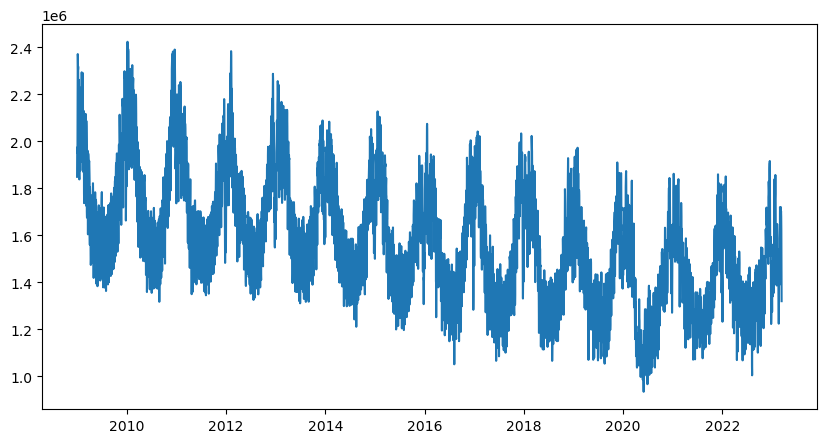

In [63]:
#Check data impute
plt.plot(df_daily['tsd'])

#### England-Wales Demand

In [64]:
#England Wales demand over time 
fig = make_subplots(rows=3, cols=1, subplot_titles=df_list)

for i, df_name in enumerate(df_list):
    fig.add_trace(go.Scatter(x=eval(df_name).index, y=eval(df_name)['england_wales_demand'], mode='lines'), row=i+1, col=1)
    fig.update_yaxes(title_text='MW', row=i+1, col=1)

fig.update_layout(title='<b>England-Wales Demand</b>',  title_x=0.5,  height=800, width=1000, xaxis_title='Date', showlegend=False)

fig.show()

England Wales column seems to have some missing data in the original data also, the missing values form the daily data are the same as for `tsd` and `nd`. 

In [65]:
#Check if england_wales_demand has values = to 0 
print(df[df['england_wales_demand'] == 0].value_counts().sum())
print(df_daily[df_daily['england_wales_demand'] == 0].value_counts().sum())

#There are 21 rows with value zero in df and 15 in df_daily

21
15


In [66]:
#Fill the missing values from england_wales_demand with the backward filling method
df['england_wales_demand'] = df['england_wales_demand'].mask(df['england_wales_demand'] < 8000, np.nan)

#There is also an unusually low value from 11-10-2010
df['england_wales_demand'].fillna(method='ffill', inplace=True)

#Check change
df[df['england_wales_demand'] < 8000]

#Fill the missing values from england_wales_demand with the backward filling method
df_daily['england_wales_demand'].replace(0, np.nan, inplace=True)
df_daily['england_wales_demand'].fillna(method='ffill', inplace=True)
df_daily[df_daily['england_wales_demand'] == 0]

,settlement_period,nd,tsd,england_wales_demand,embedded_wind_generation,embedded_wind_capacity,embedded_solar_generation,embedded_solar_capacity,non_bm_stor,pump_storage_pumping,ifa_flow,ifa2_flow,britned_flow,moyle_flow,east_west_flow,nemo_flow,is_holiday
settlement_date,,,,,,,,,,,,,,,,,


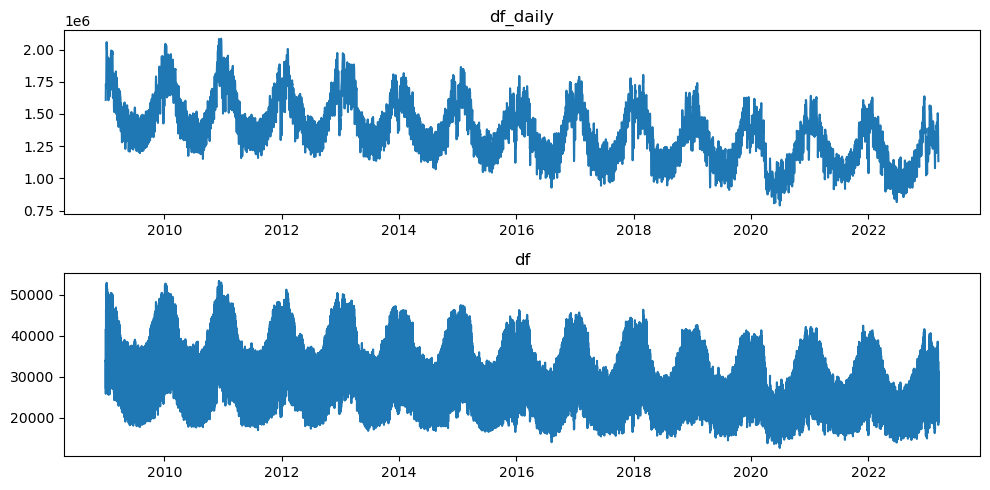

In [68]:
#Check results 
fig, axes = plt.subplots(2, 1, figsize=(10, 5))

axes[0].plot(df_daily['england_wales_demand'])
axes[0].set_title('df_daily')
axes[1].plot(df['england_wales_demand'])
axes[1].set_title('df')
plt.tight_layout()
plt.show()


This process concludes the data loading and some data fixing. Now we are going to save the dataframes for EDA and preprocessing. 

### **5. Data Saving**

In [69]:
#Save data 
df.to_csv('../data/historic_demand_2009_2023_cleaned.csv', index=True)
df_daily.to_csv('../data/daily_historic_demand_2009_2023_cleaned.csv', index=True)
df_monthly.to_csv('../data/monthly_historic_demand_2009_2023_cleaned.csv', index=True)